In [1]:
import skimage.transform
import numpy as np
from matplotlib import pyplot as plt
plt.set_cmap('terrain')
pass

In [2]:
class terran(object):
    def __init__(self,seed=42):
        self.img = np.zeros((2,3),dtype=np.float)
        self.rand = np.random.RandomState(seed=seed)
        
    def genV1(self,imax=15,smallness=0.75,scale=1.5,maxsize=10**7):
        outsize = self.img.shape[0]*self.img.shape[1]*scale**(2*(imax-1))
        assert maxsize>outsize, 'Potential Memory error: Size = 6*scale**(2*(imax-1)) = {} is above maxsize = {}'.format(outsize,maxsize)
        
        A = 1
        J = smallness
        for i in range(imax):
            self.img += self.rand.normal(scale=A*J**i,size=self.img.shape) #add noise
            if i==imax-1:
                break
            self.img = skimage.transform.rescale(self.img,scale,anti_aliasing=False,mode='reflect',multichannel=False)
    
    def addseasnow(self,img,seafrac=0.5,snowfrac=0.05):
        pmin = np.percentile(img,seafrac*100)
        pmax = np.percentile(img,(1-snowfrac)*100)
        img = np.clip(img,pmin,pmax) #make snow and sea
        return img
    
    def addbeach(self,img,vmin=0.15,vmax=0.25):
        Amin,Amax = np.min(img),np.max(img)
        img2 = (img-Amin)/(Amax-Amin) #rescale 0<=img2<=1
        img[(img2>vmin)*(img2<vmax)] = (Amax+Amin)/2 #set shoreline
        return img
    
    def plot(self,raw=False):
        #simple plotter, uses terrain colour map: https://matplotlib.org/users/colormaps.html
        img = np.copy(self.img)
        if not raw:
            img = self.addseasnow(img)
            img = self.addbeach(img)
        plt.figure(figsize=(15,12))
        plt.imshow(img,cmap='terrain')
        plt.axis('off')
        plt.tight_layout()
        plt.show()
    
    def erosion(self,nparticles,maxdeathfrac=0.5,nitts=100,f=0.5,f2=None):
        posy = np.random.randint(0,self.img.shape[0],size=(nparticles,))
        posx = np.random.randint(0,self.img.shape[1],size=(nparticles,))
        pos = np.array([posy,posx]).T
        dirs = np.array([[0,0],[0,1],[1,1],[1,0],[1,-1],[0,-1],[-1,-1],[-1,0],[-1,1]]) #(y,x)
        if f2 is None:
            f2 = f
        for i in range(nitts):
            posnewpos = (dirs[:,np.newaxis,:]+pos)
            Xnew,Ynew = posnewpos[...,1],posnewpos[...,0]
            Xnew = np.clip(Xnew,0,self.img.shape[1]-1) #edge bounce
            Ynew = np.clip(Ynew,0,self.img.shape[0]-1)
            newid = np.argmin(self.img[Ynew,Xnew],axis=0)
            posnew = np.array([Ynew[newid,np.arange(Ynew.shape[1])],Xnew[newid,np.arange(Xnew.shape[1])]]).T
            
            Yo,Xo = pos.T
            Yn,Xn = posnew.T
            deathfrac = np.mean((Yo==Yn)*(Xo==Xn))
            Cold = self.img[Yo,Xo]
            Cnew = self.img[Yn,Xn]
            DC = Cold-Cnew
            self.img[Yo,Xo] -= DC/2*f #if f = 1 than Cnew = Cold
            self.img[Yn,Xn] += DC/2*f2
            
            pos = posnew
            if maxdeathfrac<deathfrac:
                posy = np.random.randint(0,self.img.shape[0],size=(nparticles,))
                posx = np.random.randint(0,self.img.shape[1],size=(nparticles,))
                pos = np.array([posy,posx]).T
        self.pos = pos

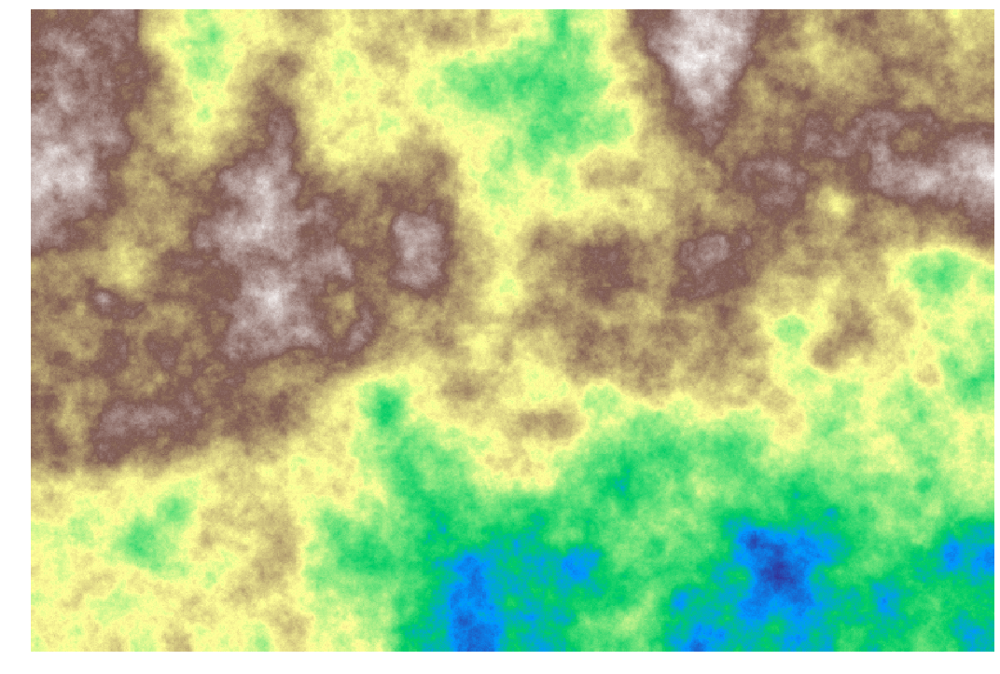

0


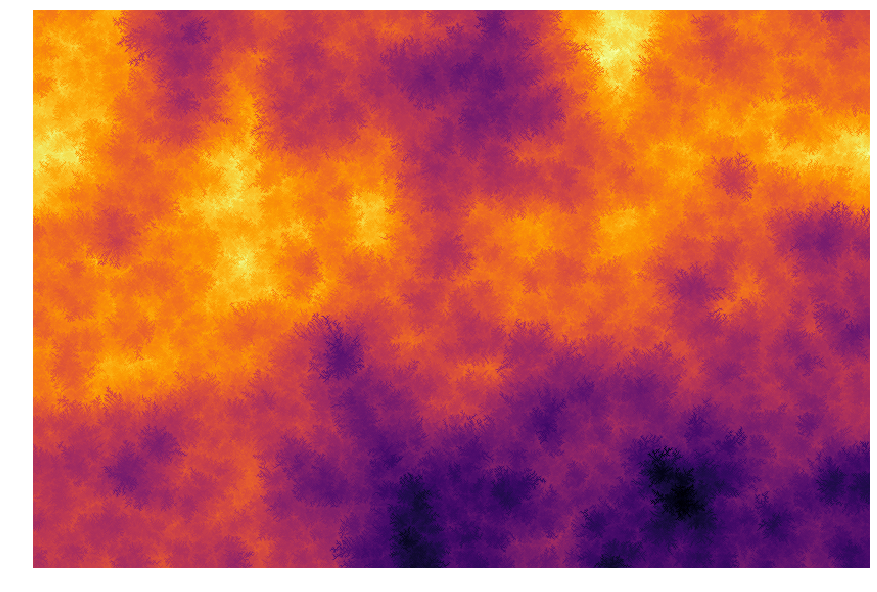

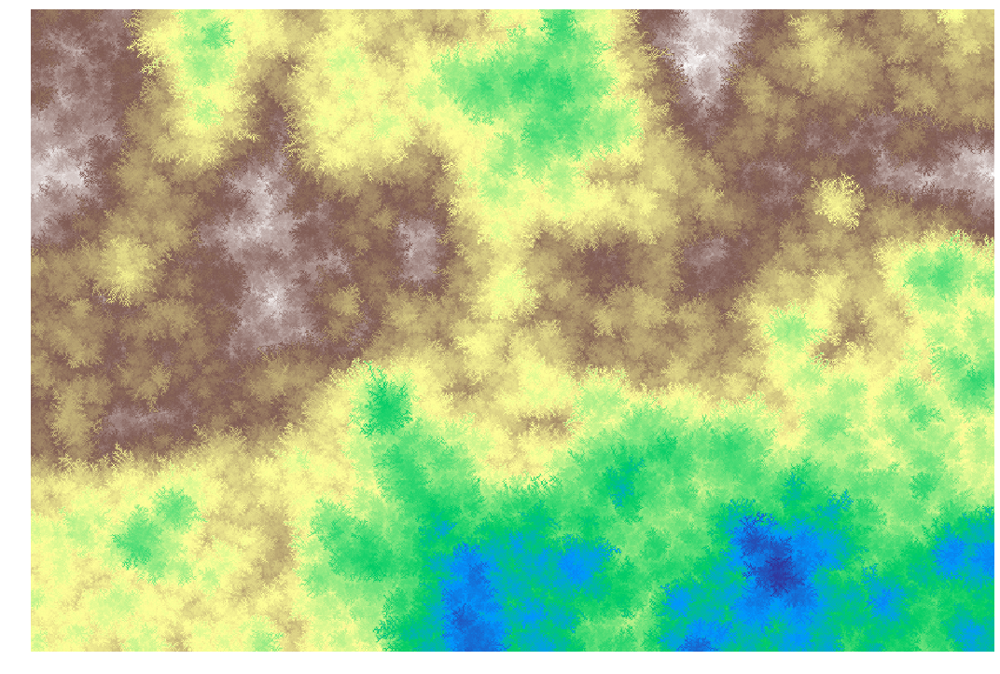

1


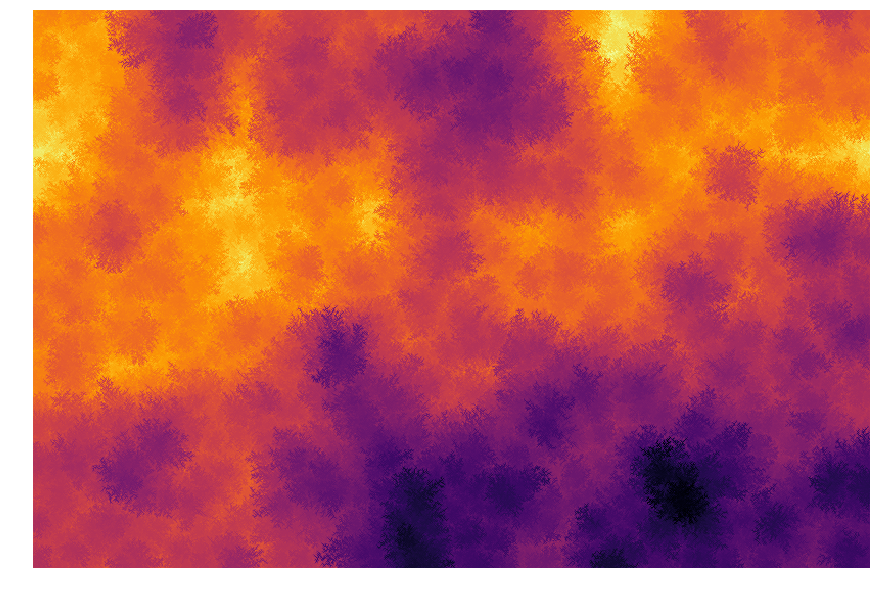

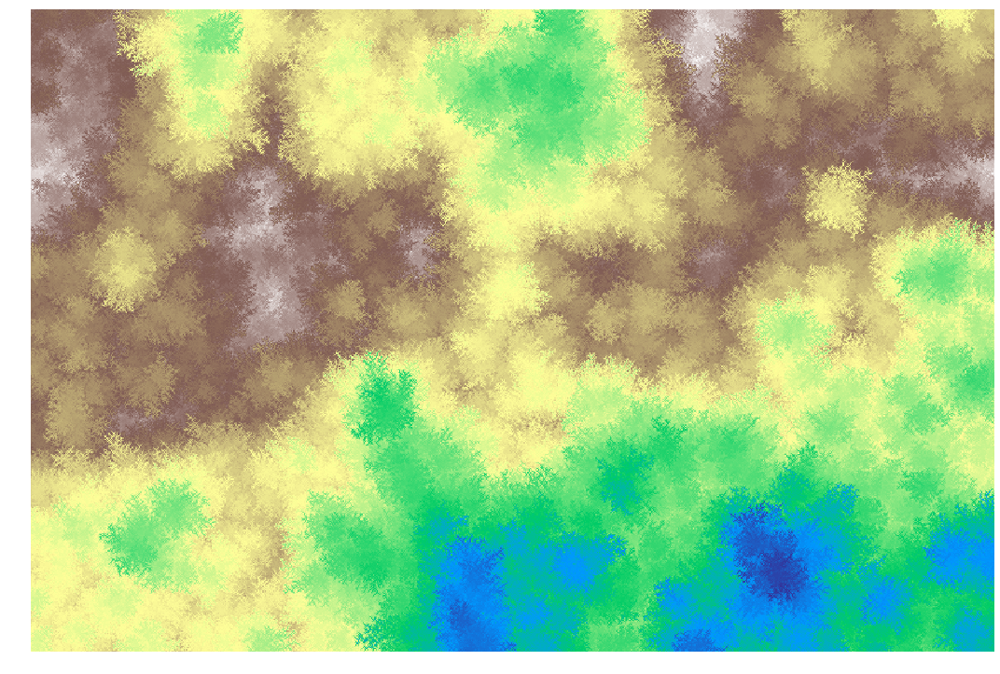

2


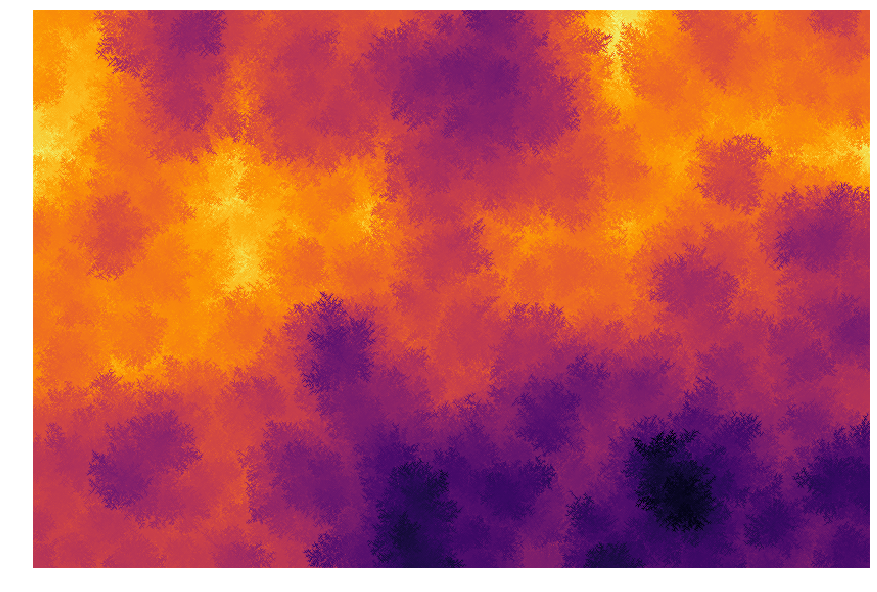

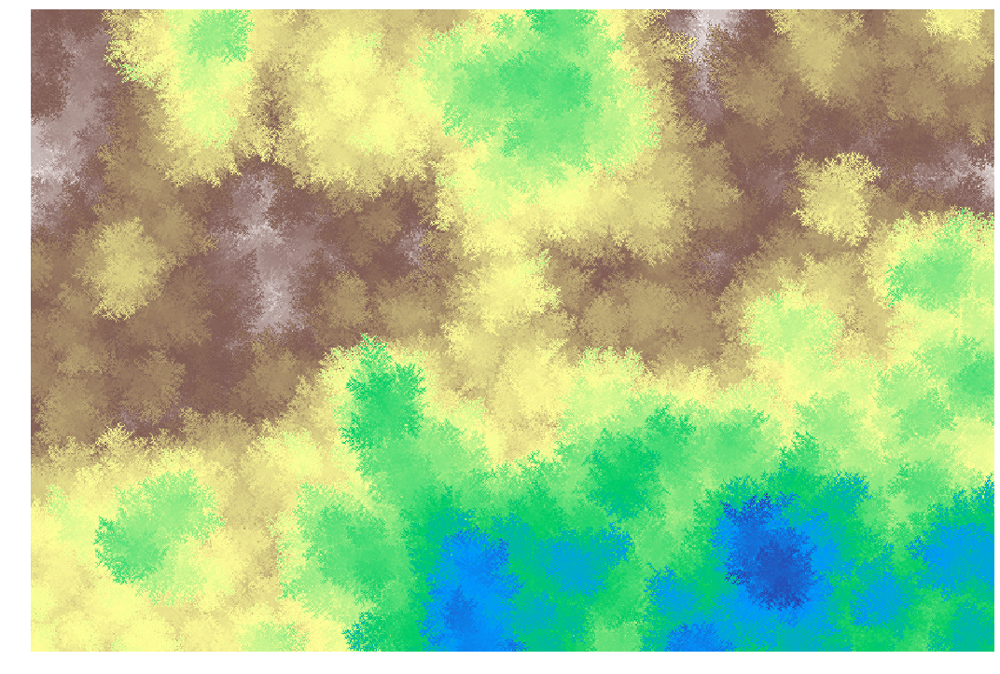

3


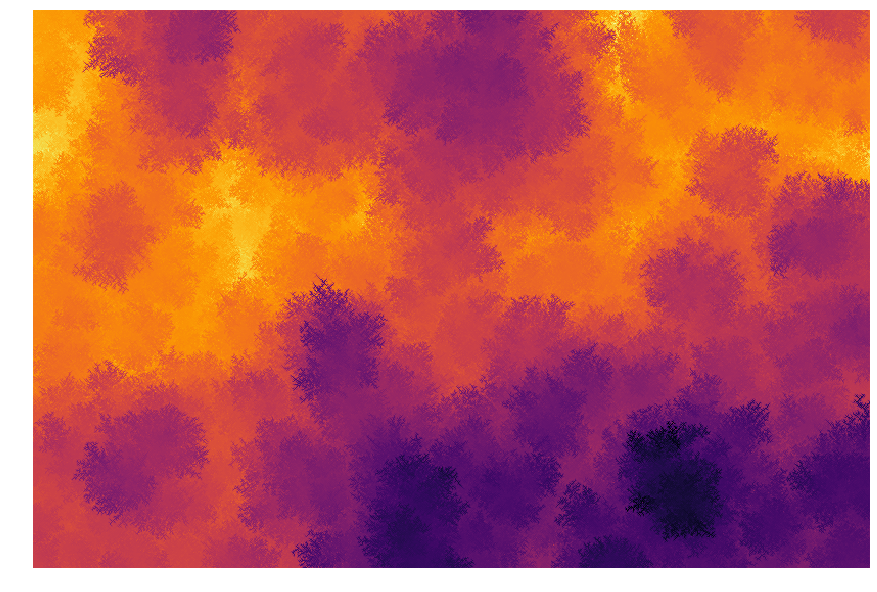

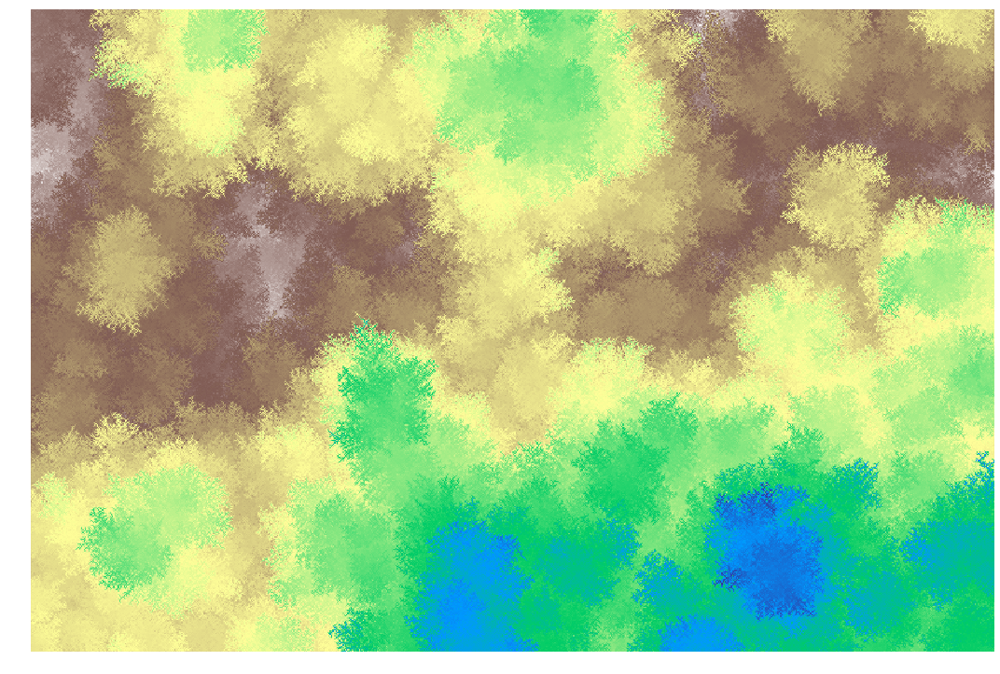

4


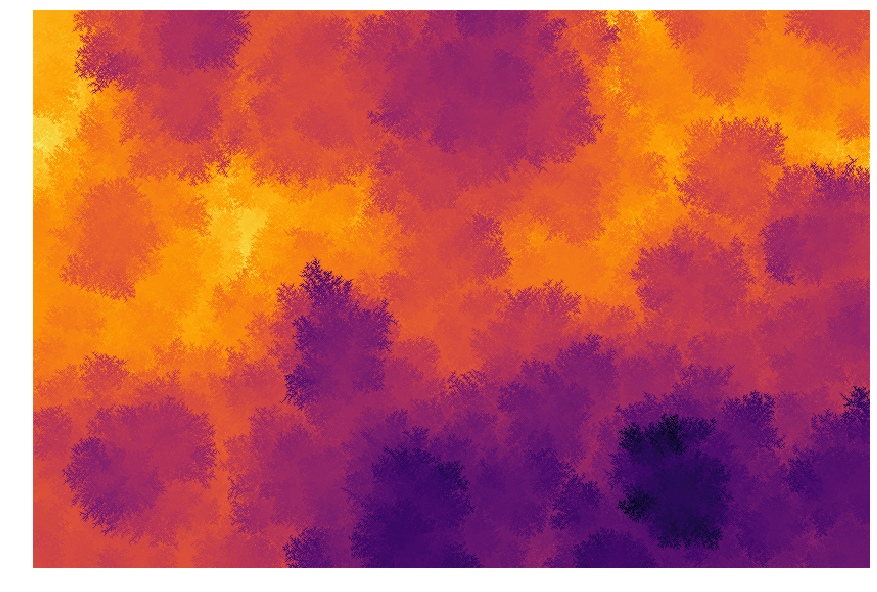

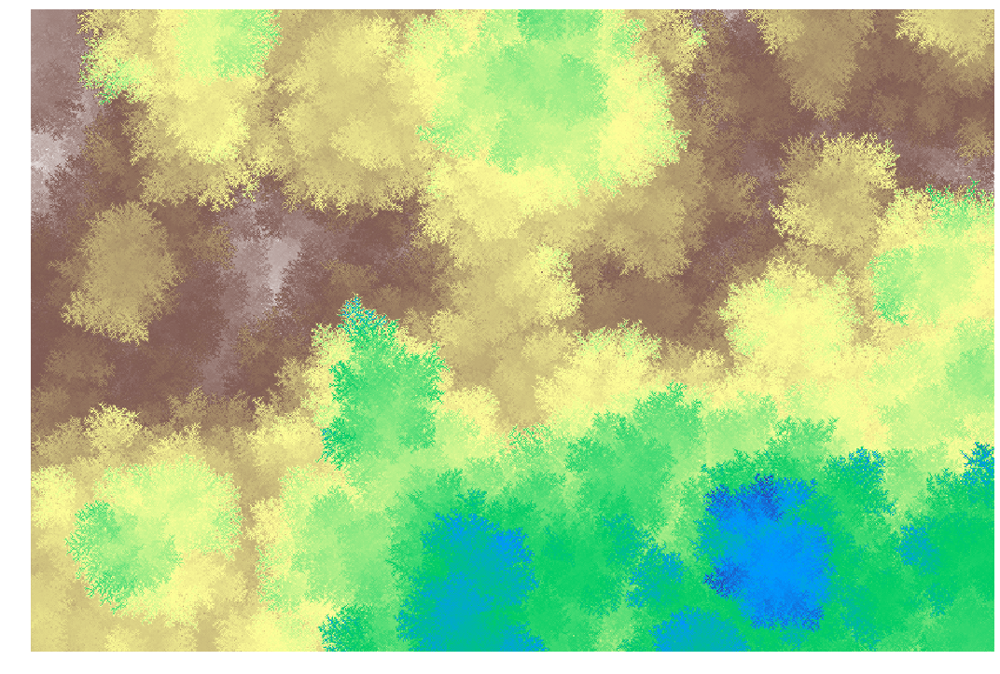

5


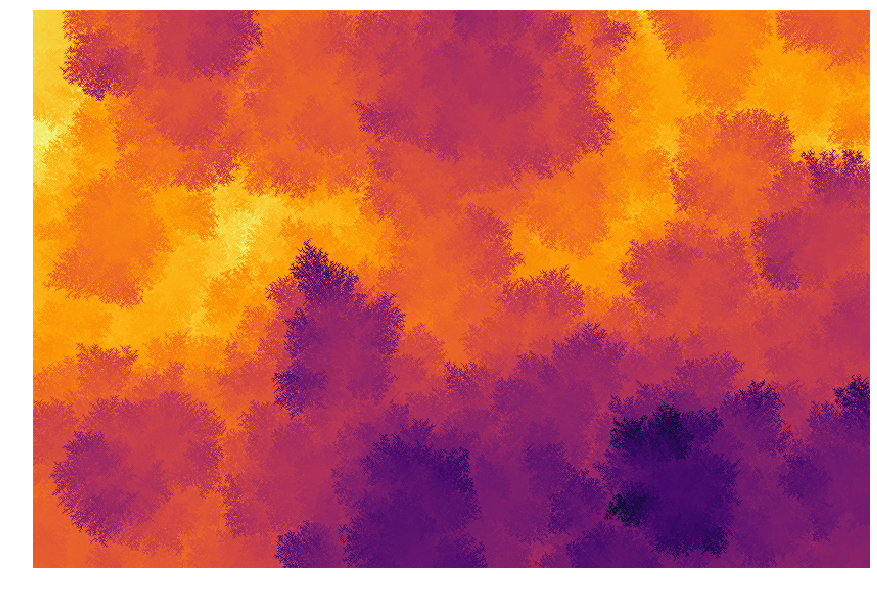

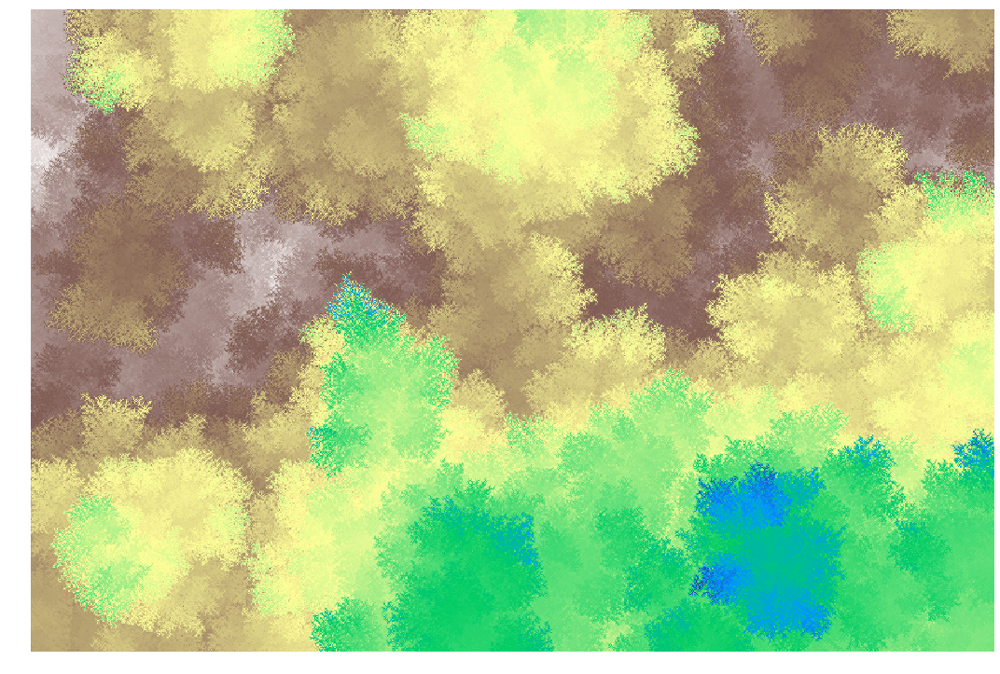

6


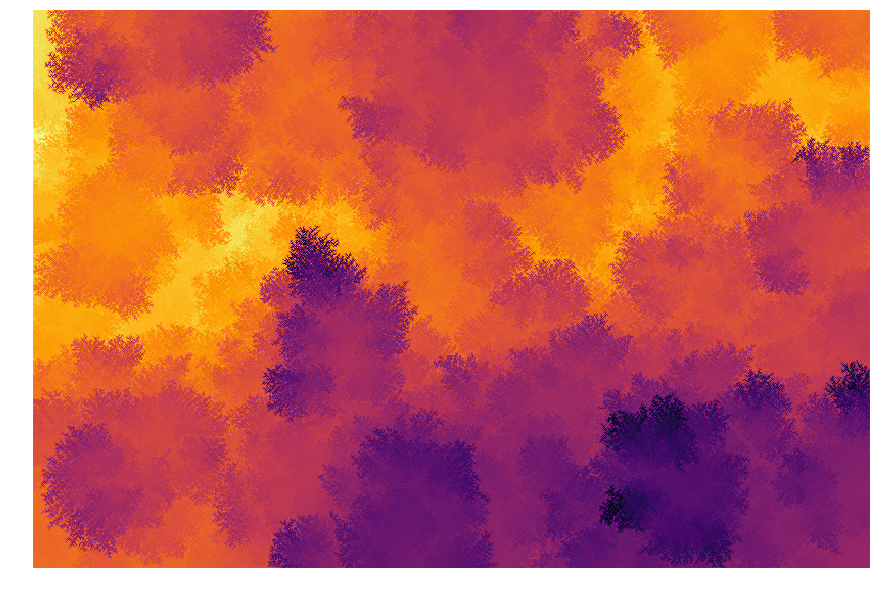

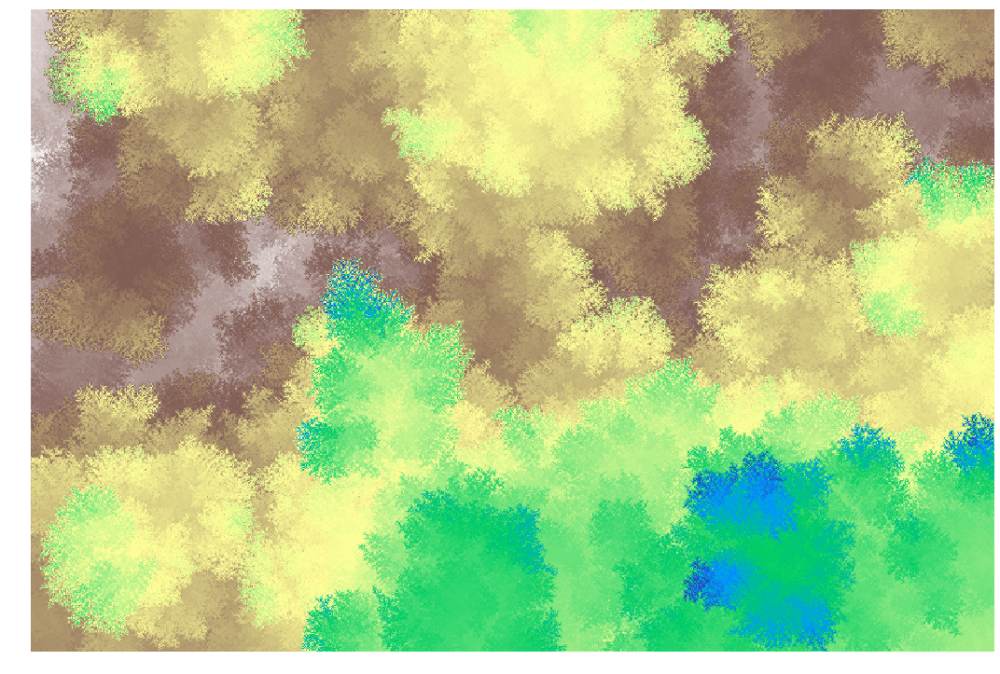

7


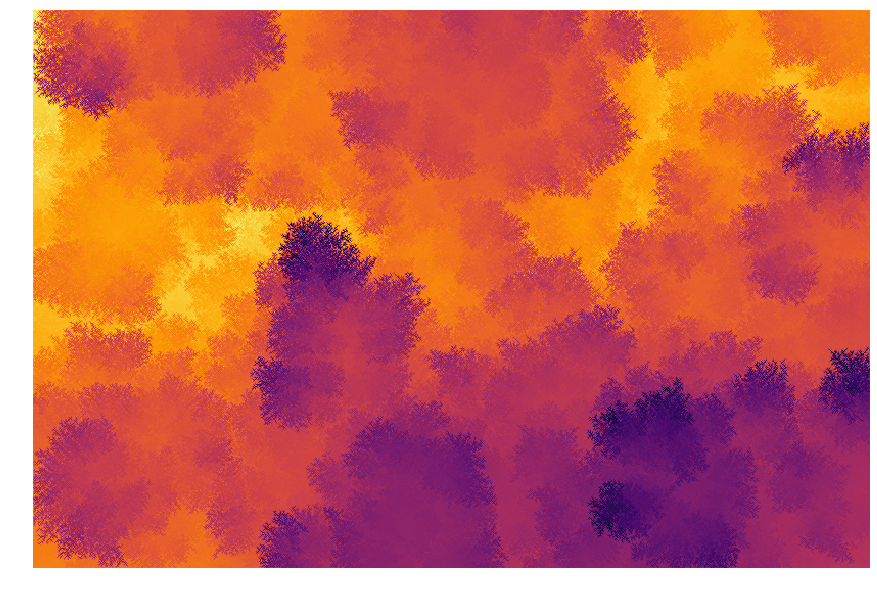

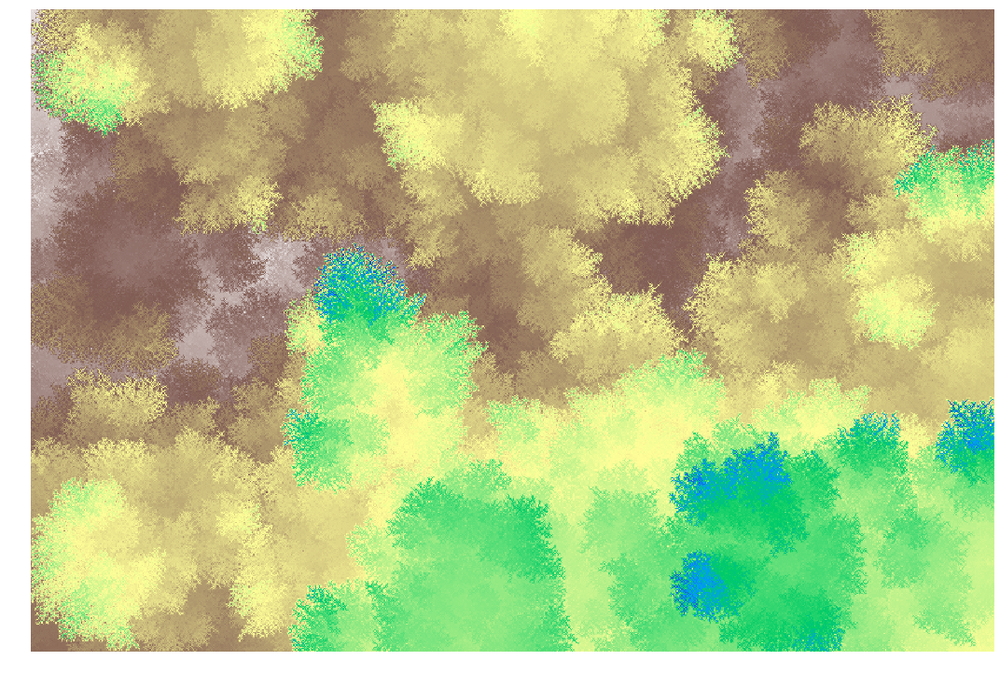

8


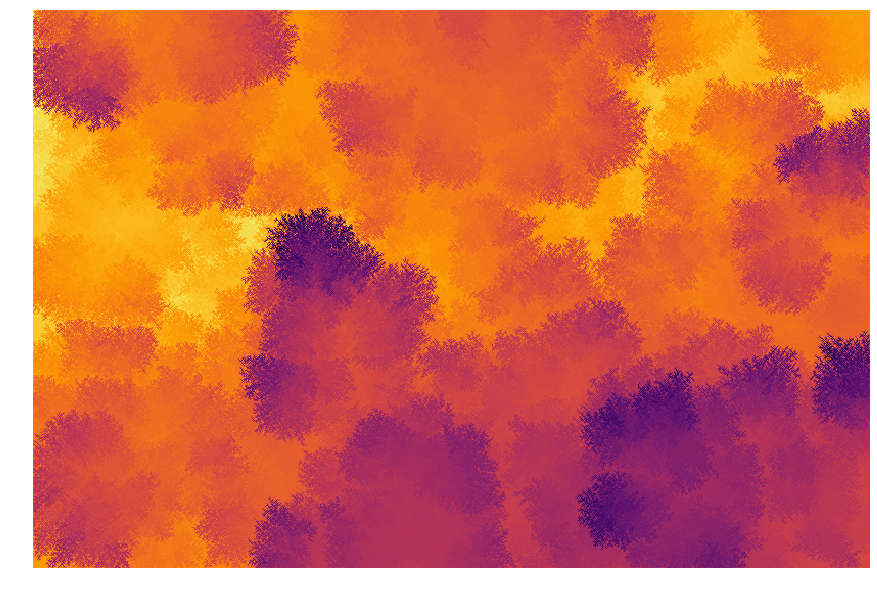

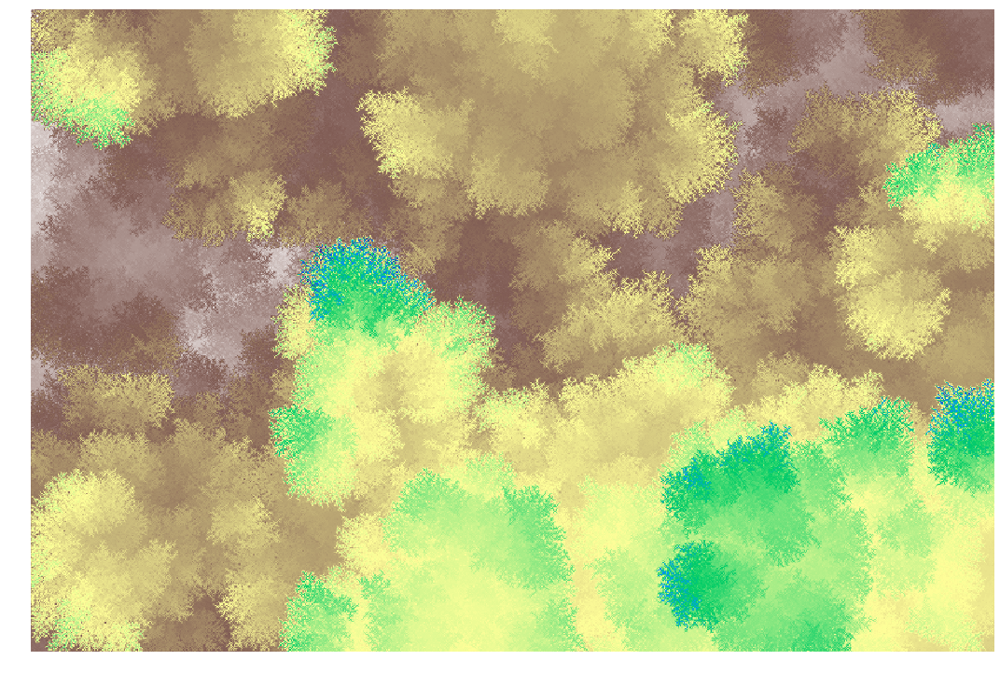

9


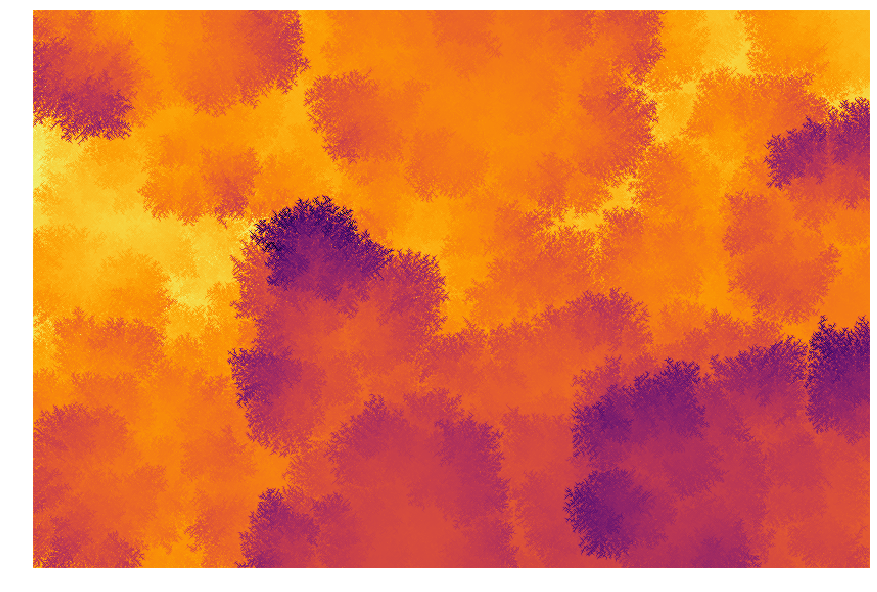

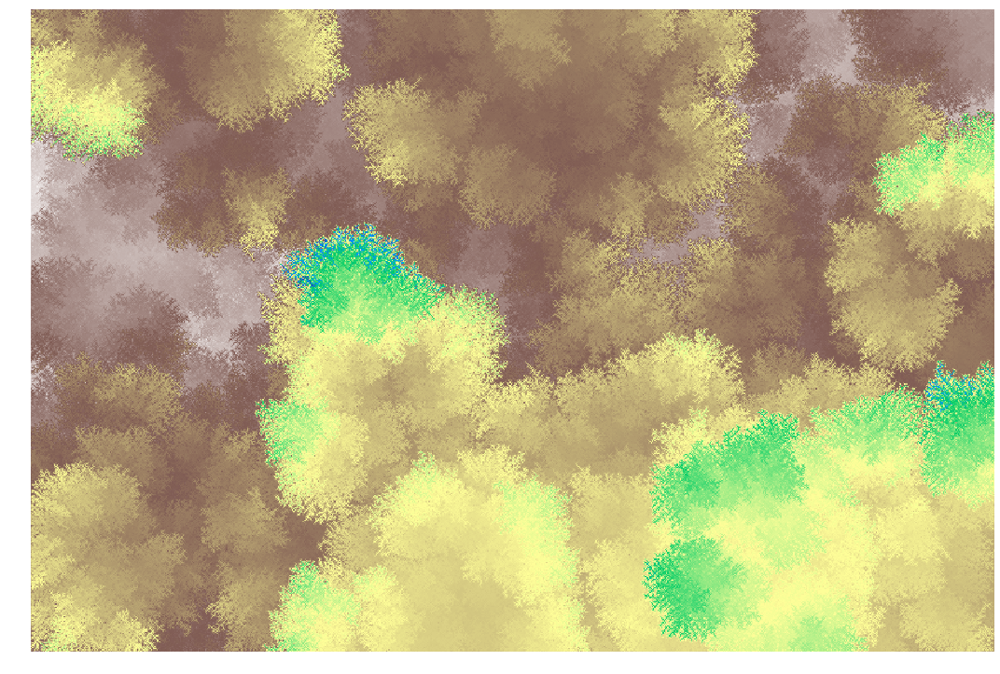

In [3]:
ter = terran(seed=45)
ter.genV1(imax=15)
ter.plot(raw=True)
for i in range(10):
    print(i)
    ter.erosion(10000,nitts=1000,f=0.5,f2=-0.02,maxdeathfrac=0.9)
    plt.figure(figsize=(15,12))
    plt.imshow(ter.img,cmap='inferno')
    plt.axis('off')
    plt.show()
    ter.plot(raw=True)

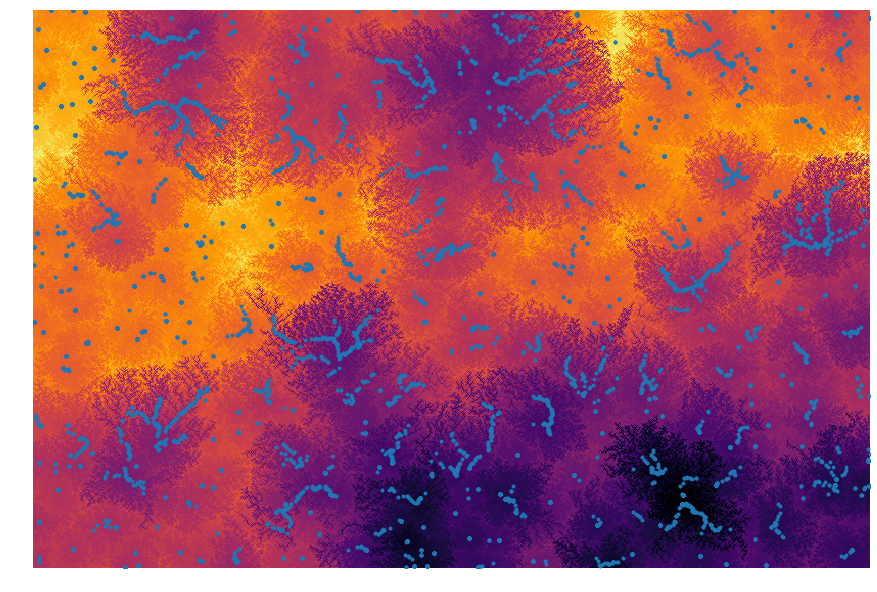

In [32]:
plt.figure(figsize=(15,12))
plt.imshow(ter.img,cmap='inferno')
plt.plot(ter.pos[:,1],ter.pos[:,0],'.')
plt.axis('off')
plt.show()

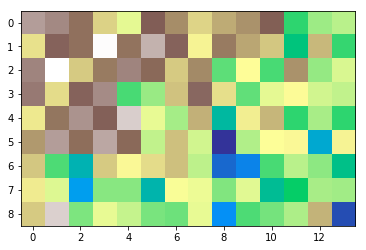

In [102]:
plt.imshow(img)
nparticles = 7
posy = np.random.randint(0,img.shape[0],size=(nparticles,))
posx = np.random.randint(0,img.shape[1],size=(nparticles,))
pos = np.array([posy,posx]).T
dirs = np.array([[0,0],[0,1],[1,1],[1,0],[1,-1],[0,-1],[-1,-1],[-1,0],[-1,1]]) #(y,x)

In [103]:
img[[0,1],[0,1]]

array([0.74855655, 0.51842051])

In [117]:
posnewpos = (dirs[:,np.newaxis,:]+pos)
Xnew,Ynew = posnewpos[...,1],posnewpos[...,0]
Xnew = np.clip(Xnew,0,img.shape[1]-1) #periodic
Ynew = np.clip(Ynew,0,img.shape[0]-1)


In [118]:
newid = np.argmin(img[Ynew,Xnew],axis=0)
Xnew[newid],Ynew[newid]

(array([[ 0,  9,  7, 12,  2, 12,  0],
        [ 2, 11,  9, 13,  4, 13,  1],
        [ 1, 10,  8, 13,  3, 13,  0],
        [ 1, 10,  8, 13,  3, 13,  0],
        [ 2, 11,  9, 13,  4, 13,  1],
        [ 0,  9,  7, 12,  2, 12,  0],
        [ 1, 10,  8, 13,  3, 13,  0]]), array([[4, 0, 2, 8, 1, 4, 0],
        [5, 1, 3, 8, 2, 5, 1],
        [4, 0, 2, 8, 1, 4, 0],
        [4, 0, 2, 8, 1, 4, 0],
        [3, 0, 1, 7, 0, 3, 0],
        [5, 1, 3, 8, 2, 5, 1],
        [5, 1, 3, 8, 2, 5, 1]]))

In [119]:
posnew = np.array([Ynew[newid,np.arange(Ynew.shape[1])],Xnew[newid,np.arange(Xnew.shape[1])]]).T

array([[ 4,  1],
       [ 0, 10],
       [ 2,  8],
       [ 8, 13],
       [ 1,  3],
       [ 4, 13],
       [ 0,  0]])

In [121]:
posnew

array([[ 4,  0],
       [ 1, 11],
       [ 2,  8],
       [ 8, 13],
       [ 0,  4],
       [ 5, 12],
       [ 1,  0]])

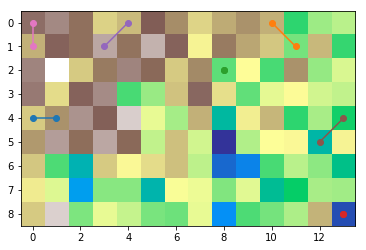

In [141]:
plt.imshow(img)
for pold,pnew in zip(pos,posnew):
    plt.plot([pold[1],pnew[1]],[pold[0],pnew[0]],'o-')
plt.show()

In [140]:
Yo,Xo = pos.T
Yn,Xn = posnew.T
Cold = img[Yo,Xo]
Cnew = img[Yn,Xn]
DC = Cold-Cnew
f = 0.5
img[Yo,Xo] -= DC/2*f
img[Yn,Xn] += DC/2*f


array([2., 1., 2., 1., 2.])